### Notebook for the niche identification in HHH LV generated with 10X Genomics Xenium with `NicheCompass`.

- **Creator**: Sebastian Birk (<sebastian.birk@helmholtz-munich.de>)
- **Modified by**: Carlos Talavera-López
- **Affiliation:** Helmholtz Munich, Institute of AI for Health (AIH), Talavera-López Lab
- **Date of Creation:** 17.05.2023
- **Date of Last Modification:** 241010

### Loading required packages and set up working environment

In [1]:
%load_ext autoreload
%autoreload 2

In [58]:
import os
import random
import warnings
from datetime import datetime


import math
import gdown
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import squidpy as sq
from pywaffle import Waffle
from matplotlib import gridspec
from scipy.cluster import hierarchy
from sklearn.preprocessing import MinMaxScaler


from nichecompass.models import NicheCompass
from nichecompass.utils import (add_gps_from_gp_dict_to_adata,
                                compute_communication_gp_network,
                                visualize_communication_gp_network,
                                create_new_color_dict,
                                extract_gp_dict_from_mebocost_ms_interactions,
                                extract_gp_dict_from_nichenet_lrt_interactions,
                                extract_gp_dict_from_omnipath_lr_interactions,
                                filter_and_combine_gp_dict_gps_v2,
                                generate_enriched_gp_info_plots)

### Define `NicheCompass` Model Parameters

- Dataset

In [3]:
dataset = "xenium_human_heart"
species = "human"
spatial_key = "spatial"
n_neighbors = 8

- AnnData keys

In [ ]:
counts_key = "counts"
adj_key = "spatial_connectivities"
gp_names_key = "nichecompass_gp_names"
active_gp_names_key = "nichecompass_active_gp_names"
gp_targets_mask_key = "nichecompass_gp_targets"
gp_targets_categories_mask_key = "nichecompass_gp_targets_categories"
gp_sources_mask_key = "nichecompass_gp_sources"
gp_sources_categories_mask_key = "nichecompass_gp_sources_categories"
latent_key = "nichecompass_latent"

- Architecture

In [ ]:
conv_layer_encoder = "gatv2conv" 
active_gp_thresh_ratio = 0.01

- Trainer

In [ ]:
n_epochs = 400
n_epochs_all_gps = 25
lr = 0.001
lambda_edge_recon = 500000.
lambda_gene_expr_recon = 300.
lambda_l1_masked = 0. # prior GP  regularization
lambda_l1_addon = 3. # de novo GP regularization
edge_batch_size = 1024 # increase if more memory available or decrease to save memory
n_sampled_neighbors = 4
use_cuda_if_available = True

- Analysis

In [ ]:
cell_type_key = "cell_type"
latent_leiden_resolution = 0.4
latent_cluster_key = f"latent_leiden_{str(latent_leiden_resolution)}"
sample_key = "batch"
spot_size = 30
random_seed = 1712
differential_gp_test_results_key = "nichecompass_differential_gp_test_results"

In [4]:
warnings.filterwarnings("ignore")

- Get time of notebook execution for timestamping saved artifacts


In [5]:
now = datetime.now()
current_timestamp = now.strftime("%d%m%Y_%H%M%S")

- Configure Paths

In [6]:
ga_data_folder_path = "/home/ruth/github/nichecompass/data/gene_annotations"
gp_data_folder_path = "/home/ruth/github/nichecompass/data/gene_programs"
so_data_folder_path = "/home/ruth/github/nichecompass/data/spatial_omics"
omnipath_lr_network_file_path = f"{gp_data_folder_path}/omnipath_lr_network.csv"
collectri_tf_network_file_path = f"{gp_data_folder_path}/collectri_tf_network_{species}.csv"
nichenet_lr_network_file_path = f"{gp_data_folder_path}/nichenet_lr_network_v2_{species}.csv"
nichenet_ligand_target_matrix_file_path = f"{gp_data_folder_path}/nichenet_ligand_target_matrix_v2_{species}.csv"
mebocost_enzyme_sensor_interactions_folder_path = f"{gp_data_folder_path}/metabolite_enzyme_sensor_gps"
gene_orthologs_mapping_file_path = f"{ga_data_folder_path}/human_mouse_gene_orthologs.csv"
artifacts_folder_path = f"./artifacts"
model_folder_path = f"{artifacts_folder_path}/single_sample/{current_timestamp}/model"
figure_folder_path = f"{artifacts_folder_path}/single_sample/{current_timestamp}/figures"

- Create Directories

In [7]:
os.makedirs(model_folder_path, exist_ok=True)
os.makedirs(figure_folder_path, exist_ok=True)
os.makedirs(so_data_folder_path, exist_ok=True)

### Load and explore data

In [8]:
adata = sc.read_h5ad("../data/nc/xenium_10Xheart_annotated_raw.h5ad")
adata

AnnData object with n_obs × n_vars = 25725 × 310
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'cell_labels', 'n_counts', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [9]:
adata.layers["counts"] = adata.X.copy()
adata.layers["counts"]

<Compressed Sparse Row sparse matrix of dtype 'float32'
	with 632879 stored elements and shape (25725, 310)>

In [10]:
adata.var

,gene_ids,feature_types,genome,n_cells
ACE2,ENSG00000130234,Gene Expression,Unknown,961
ACKR1,ENSG00000213088,Gene Expression,Unknown,621
ACTA2,ENSG00000107796,Gene Expression,Unknown,3159
ACTG2,ENSG00000163017,Gene Expression,Unknown,10898
ADAM28,ENSG00000042980,Gene Expression,Unknown,320
...,...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown,271
VCAN,ENSG00000038427,Gene Expression,Unknown,2344
VSIG4,ENSG00000155659,Gene Expression,Unknown,854
VWA5A,ENSG00000110002,Gene Expression,Unknown,522


### Prepare Model Training

#### Create Prior Knowledge Gene Program (GP) Mask

- NicheCompass expects a prior GP mask as input, which it will use to make its latent feature space interpretable (through linear masked decoders). 
- The user can provide a custom GP mask to NicheCompass based on the biological question of interest.
- As a default, here we create a GP mask based on three databases of prior knowledge of inter- and intracellular interaction pathways:
    - OmniPath (Ligand-Receptor GPs)
    - MEBOCOST (Enzyme-Sensor GPs)
    - NicheNet (Combined Interaction GPs)

- Retrieve OmniPath GPs (source: ligand genes; target: receptor genes)

In [11]:
omnipath_gp_dict = extract_gp_dict_from_omnipath_lr_interactions(
    species=species,
    load_from_disk=False,
    save_to_disk=True,
    lr_network_file_path=omnipath_lr_network_file_path,
    gene_orthologs_mapping_file_path=gene_orthologs_mapping_file_path,
    plot_gp_gene_count_distributions=False)

- Retrieve NicheNet GPs (source: ligand genes; target: receptor genes, target genes)

In [12]:
nichenet_gp_dict = extract_gp_dict_from_nichenet_lrt_interactions(
    species=species,
    version="v2",
    load_from_disk=False,
    save_to_disk=True,
    lr_network_file_path=nichenet_lr_network_file_path,
    ligand_target_matrix_file_path=nichenet_ligand_target_matrix_file_path,
    gene_orthologs_mapping_file_path=gene_orthologs_mapping_file_path,
    plot_gp_gene_count_distributions=False)

- Retrieve MEBOCOST GPs (source: enzyme genes; target: sensor genes)

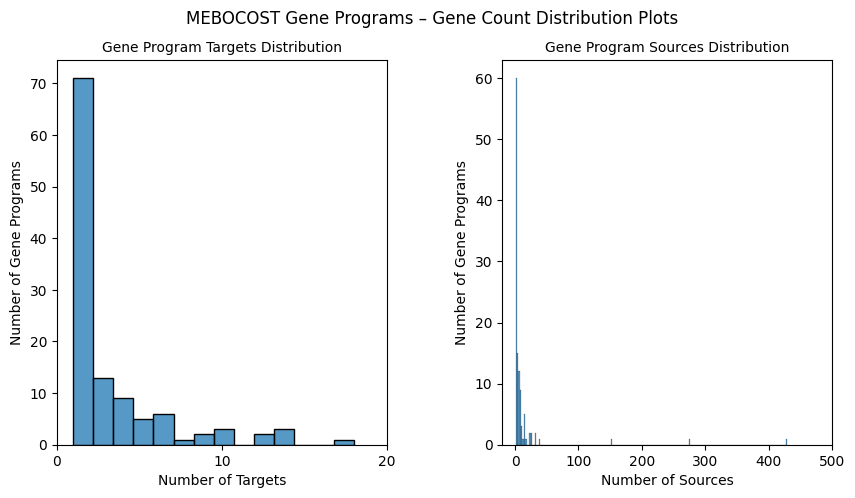

In [13]:
mebocost_gp_dict = extract_gp_dict_from_mebocost_ms_interactions(
    dir_path=mebocost_enzyme_sensor_interactions_folder_path,
    species='human',
    plot_gp_gene_count_distributions=True)

- Filter and combine GPs

In [14]:
gp_dicts = [omnipath_gp_dict, nichenet_gp_dict, mebocost_gp_dict]
combined_gp_dict = filter_and_combine_gp_dict_gps_v2(
    gp_dicts,
    verbose=True)

print(f"Number of gene programs after filtering and combining: "
      f"{len(combined_gp_dict)}.")

Combining ACE2_ligand_receptor_GP and ACE2_ligand_receptor_target_gene_GP.
Combining ADCYAP1_ligand_receptor_GP and ADCYAP1_ligand_receptor_target_gene_GP.
Combining ADGRE5_ligand_receptor_GP and ADGRE5_ligand_receptor_target_gene_GP.
Combining ADIPOQ_ligand_receptor_GP and ADIPOQ_ligand_receptor_target_gene_GP.
Combining ADM_ligand_receptor_GP and ADM_ligand_receptor_target_gene_GP.
Combining ADM2_ligand_receptor_GP and ADM2_ligand_receptor_target_gene_GP.
Combining AGRP_ligand_receptor_GP and AGRP_ligand_receptor_target_gene_GP.
Combining AGT_ligand_receptor_GP and AGT_ligand_receptor_target_gene_GP.
Combining ALCAM_ligand_receptor_GP and ALCAM_ligand_receptor_target_gene_GP.
Combining ALKAL1_ligand_receptor_GP and ALKAL1_ligand_receptor_target_gene_GP.
Combining ALKAL2_ligand_receptor_GP and ALKAL2_ligand_receptor_target_gene_GP.
Combining AMBN_ligand_receptor_GP and AMBN_ligand_receptor_target_gene_GP.
Combining AMELX_ligand_receptor_GP and AMELX_ligand_receptor_target_gene_GP.
Com

In [15]:
combined_gp_dict

{'ACTR2_ligand_receptor_GP': {'sources': ['ACTR2'],
  'targets': ['ACVR1B'],
  'sources_categories': ['ligand'],
  'targets_categories': ['receptor']},
 'AFDN_ligand_receptor_GP': {'sources': ['AFDN'],
  'targets': ['NRXN3',
   'EPHB6',
   'NECTIN2',
   'NRXN2',
   'NECTIN4',
   'EPHA7',
   'EPHB2',
   'EPHB3',
   'NECTIN1',
   'SRC'],
  'sources_categories': ['ligand'],
  'targets_categories': ['receptor',
   'receptor',
   'receptor',
   'receptor',
   'receptor',
   'receptor',
   'receptor',
   'receptor',
   'receptor',
   'receptor']},
 'AGTRAP_ligand_receptor_GP': {'sources': ['AGTRAP'],
  'targets': ['RACK1'],
  'sources_categories': ['ligand'],
  'targets_categories': ['receptor']},
 'ARF4_ligand_receptor_GP': {'sources': ['ARF4'],
  'targets': ['EGFR'],
  'sources_categories': ['ligand'],
  'targets_categories': ['receptor']},
 'ARF6_ligand_receptor_GP': {'sources': ['ARF6'],
  'targets': ['PIP5K1A', 'MAPK3', 'PLD1', 'PIP5K1C', 'MAPK1'],
  'sources_categories': ['ligand'],
  

### Load Data and Compute Spatial Neighbor Graph

- NicheCompass expects a precomputed spatial adjacency matrix stored in 'adata.obsp[adj_key]'.
- The user can customize the spatial neighbor graph construction based on the biological question of interest.

- Compute spatial neighborhood

In [17]:
sq.gr.spatial_neighbors(adata,
                        coord_type="generic",
                        spatial_key=spatial_key,
                        n_neighs=n_neighbors)

- Make adjacency matrix symmetric

In [ ]:
adata.obsp[adj_key] = (
    adata.obsp[adj_key].maximum(
        adata.obsp[adj_key].T))

### Add GP Mask to Data

- Add the GP dictionary as binary masks to the adata

In [18]:
add_gps_from_gp_dict_to_adata(
    gp_dict=combined_gp_dict,
    adata=adata,
    gp_targets_mask_key=gp_targets_mask_key,
    gp_targets_categories_mask_key=gp_targets_categories_mask_key,
    gp_sources_mask_key=gp_sources_mask_key,
    gp_sources_categories_mask_key=gp_sources_categories_mask_key,
    gp_names_key=gp_names_key,
    min_genes_per_gp=2,
    min_source_genes_per_gp=1,
    min_target_genes_per_gp=1,
    max_genes_per_gp=None,
    max_source_genes_per_gp=None,
    max_target_genes_per_gp=None)

### Explore spatial distribution of variables

In [19]:
cell_type_colors = create_new_color_dict(
    adata=adata,
    cat_key=cell_type_key)

In [20]:
adata.layers["counts"] = adata.X.copy()
adata.layers["counts"]

<Compressed Sparse Row sparse matrix of dtype 'float32'
	with 632879 stored elements and shape (25725, 310)>

In [ ]:
print(f"Number of nodes (observations): {adata.layers['counts'].shape[0]}")
print(f"Number of node features (genes): {adata.layers['counts'].shape[1]}")

Number of nodes (observations): 25725
Number of node features (genes): 310


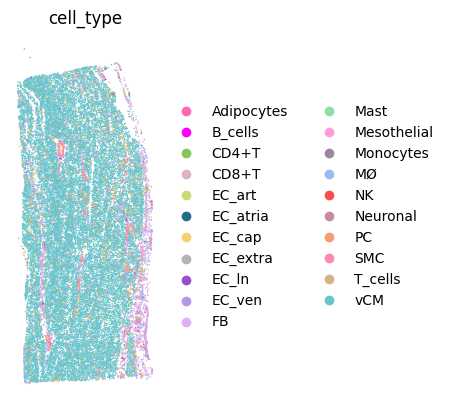

In [21]:
sc.pl.spatial(adata,
              color=cell_type_key,
              palette=cell_type_colors,
              spot_size=spot_size,
              frameon = False)        

### Initialise, Train, and Save Model

- Initialize model

In [22]:
model = NicheCompass(adata,
                     counts_key=counts_key,
                     adj_key=adj_key,
                     gp_names_key=gp_names_key,
                     active_gp_names_key=active_gp_names_key,
                     gp_targets_mask_key=gp_targets_mask_key,
                     gp_targets_categories_mask_key=gp_targets_categories_mask_key,
                     gp_sources_mask_key=gp_sources_mask_key,
                     gp_sources_categories_mask_key=gp_sources_categories_mask_key,
                     latent_key=latent_key,
                     conv_layer_encoder=conv_layer_encoder,
                     active_gp_thresh_ratio=active_gp_thresh_ratio)

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, rna_recon_loss: nb
NODE LABEL METHOD -> one-hop-norm
ACTIVE GP THRESHOLD RATIO -> 0.01
LOG VARIATIONAL -> True
ONE HOP GCN NORM RNA NODE LABEL AGGREGATOR
ENCODER -> n_input: 310, n_cat_covariates_embed_input: 0, n_hidden: 158, n_latent: 58, n_addon_latent: 100, n_fc_layers: 1, n_layers: 1, conv_layer: gatv2conv, n_attention_heads: 4, dropout_rate: 0.0, 
COSINE SIM GRAPH DECODER -> dropout_rate: 0.0
MASKED TARGET RNA DECODER -> n_prior_gp_input: 58, n_addon_gp_input: 100, n_cat_covariates_embed_input: 0, n_output: 310
MASKED SOURCE RNA DECODER -> n_prior_gp_input: 58, n_addon_gp_input: 100, n_cat_covariates_embed_input: 0, n_output: 310


- Train model

In [23]:
model.train(n_epochs=n_epochs,
            n_epochs_all_gps=n_epochs_all_gps,
            lr=lr,
            lambda_edge_recon=lambda_edge_recon,
            lambda_gene_expr_recon=lambda_gene_expr_recon,
            lambda_l1_masked=lambda_l1_masked,
            edge_batch_size=edge_batch_size,
            n_sampled_neighbors=n_sampled_neighbors,
            use_cuda_if_available=use_cuda_if_available,
            verbose=False)


--- INITIALIZING TRAINER ---
Number of training nodes: 23153
Number of validation nodes: 2572
Number of training edges: 105934
Number of validation edges: 11770
Edge batch size: 1024
Node batch size: None

--- MODEL TRAINING ---
Epoch 1/400 |--------------------| 0.2% train_global_loss: 451621.8080; train_optim_loss: 451621.8080; val_global_loss: 402112.5130; val_optim_loss: 402112.5130
Epoch 2/400 |--------------------| 0.5% train_global_loss: 384037.9267; train_optim_loss: 384037.9267; val_global_loss: 390031.1510; val_optim_loss: 390031.1510
Epoch 3/400 |--------------------| 0.8% train_global_loss: 377122.8317; train_optim_loss: 377122.8317; val_global_loss: 385397.1901; val_optim_loss: 385397.1901
Epoch 4/400 |--------------------| 1.0% train_global_loss: 373103.6683; train_optim_loss: 373103.6683; val_global_loss: 380736.0521; val_optim_loss: 380736.0521
Epoch 5/400 |--------------------| 1.2% train_global_loss: 368942.4829; train_optim_loss: 368942.4829; val_global_loss: 377929

- Compute and visualise latent neighbor graph

In [24]:

sc.pp.neighbors(model.adata,
                use_rep=latent_key,
                key_added=latent_key,
                random_state=random_seed)

In [ ]:
sc.tl.umap(model.adata,
           neighbors_key=latent_key,
           min_dist = 0.2,
           spread = 1,
           random_state=random_seed)

- Save trained model

In [25]:
model.save(dir_path=model_folder_path,
           overwrite=True,
           save_adata=True,
           adata_file_name="adata_ct241010.h5ad")

## Analysis of the niches inferred by `NicheCompass` model

In [26]:
load_timestamp = current_timestamp # uncomment if you trained the model in this notebook

figure_folder_path = f"{artifacts_folder_path}/single_sample/{load_timestamp}/figures"
model_folder_path = f"{artifacts_folder_path}/single_sample/{load_timestamp}/model"

os.makedirs(figure_folder_path, exist_ok=True)

In [27]:
model.adata.obs[sample_key] = "batch1"

In [28]:
samples = model.adata.obs[sample_key].unique().tolist()
samples

['batch1']

### Visualise NicheCompass Latent GP Space

Let's look at the preservation of cell type annotations in the latent GP space. Note that the goal of NicheCompass is not a separation of cell types but rather to identify spatially consistent cell niches.

In [29]:
cell_type_colors = {
    'vCM': '#ffde17',
    'EC_cap': '#000000',
    'PC': '#45B7D1',
    'FB': '#0437F2',
    'CD4+T': '#4ECDC4',
    'MØ': '#be1e2d',
    'SMC': '#C06C84',
    'EC_art': '#6C5B7B',
    'Mast': '#35A79C',
    'EC_ven': '#82B1FF',
    'T_cells': '#16A085',
    'EC_extra': '#5D737E',
    'EC_atria': '#3498DB',
    'CD8+T': '#F64C72',
    'Neuronal': '#9B59B6',
    'Monocytes': '#FF6B6B',
    'NK': '#E74C3C',
    'EC_ln': '#2ECC71',
    'Mesothelial': '#FF8C42',
    'Adipocytes': '#D35400',
    'B_cells': '#8E44AD',
    '-1': '#7F8C8D'
}

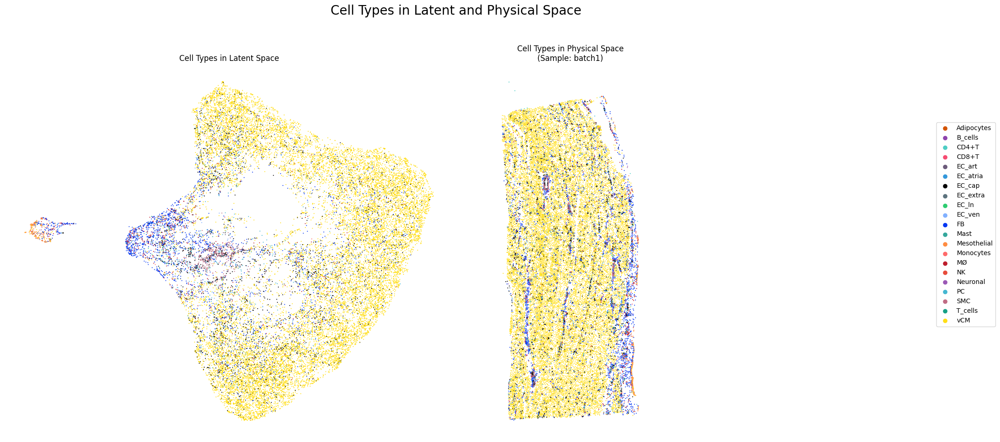

In [30]:
groups = None
save_fig = True
file_path = f"{figure_folder_path}/cell_types_latent_physical_space.svg"

n_spatial_rows = (len(samples) + 1) // 2  # Round up division by 2

fig = plt.figure(figsize=(20, 5 + 5 * n_spatial_rows))
title = fig.suptitle(t="Cell Types in Latent and Physical Space",
                     y=0.98,
                     fontsize=20)

gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

gs_left = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec=gs[0])
ax_umap = fig.add_subplot(gs_left[0])

gs_right = gridspec.GridSpecFromSubplotSpec(n_spatial_rows, 2, subplot_spec=gs[1])

sc.pl.umap(adata=model.adata,
           color=[cell_type_key],
           groups=groups,
           palette=cell_type_colors,
           title="Cell Types in Latent Space",
           ax=ax_umap,
           frameon=False,
           size=8,
           show=False)

for idx, sample in enumerate(samples):
    row = idx // 2
    col = idx % 2
    ax = fig.add_subplot(gs_right[row, col])
    sc.pl.spatial(adata=model.adata[model.adata.obs[sample_key] == sample],
                  color=[cell_type_key],
                  groups=groups,
                  palette=cell_type_colors,
                  spot_size=spot_size,
                  title=f"Cell Types in Physical Space\n(Sample: {sample})",
                  legend_loc=None,
                  ax=ax,
                  frameon=False,
                  size=0.6,
                  show=False)

handles, labels = ax_umap.get_legend_handles_labels()
lgd = fig.legend(handles,
                 labels,
                 loc="center left",
                 bbox_to_anchor=(1.02, 0.5))
ax_umap.get_legend().remove()

plt.tight_layout(rect=[0, 0.02, 1, 0.95])  # Adjust the rect parameters as needed

if save_fig:
    fig.savefig(file_path,
                bbox_extra_artists=(lgd, title),
                bbox_inches="tight")
plt.show()

### Identify Niches

- Compute latent Leiden clustering

We compute Leiden clustering of the NicheCompass latent GP space to identify spatially consistent cell niches.

In [31]:
sc.tl.leiden(adata=model.adata,
             resolution=latent_leiden_resolution,
             key_added=latent_cluster_key,
             neighbors_key=latent_key,
             random_state=random_seed)
model.adata.obs[latent_cluster_key].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'], dtype='object')

In [32]:
latent_cluster_colors = {
    '4': '#E30613',  # Vivid red
    '8': '#F6A800',  # Golden yellow
    '2': '#FF6B00',  # Bright orange
    '3': '#E3256B',  # Magenta
    '0': '#7B2AB3',  # Royal purple
    '1': '#E1DD72',  # Chartreuse
    '6': '#003399',  # Ultramarine blue
    '5': '#00A0B0',  # Turquoise
    '9': '#0087CB',  # Cobalt blue
    '7': '#8B4513',  # Saddle brown
    '10': '#18981D', # Emerald green
    '11': '#2C2C2C'  # Almost black
}
latent_cluster_colors

{'4': '#E30613',
 '8': '#F6A800',
 '2': '#FF6B00',
 '3': '#E3256B',
 '0': '#7B2AB3',
 '1': '#E1DD72',
 '6': '#003399',
 '5': '#00A0B0',
 '9': '#0087CB',
 '7': '#8B4513',
 '10': '#18981D',
 '11': '#2C2C2C'}

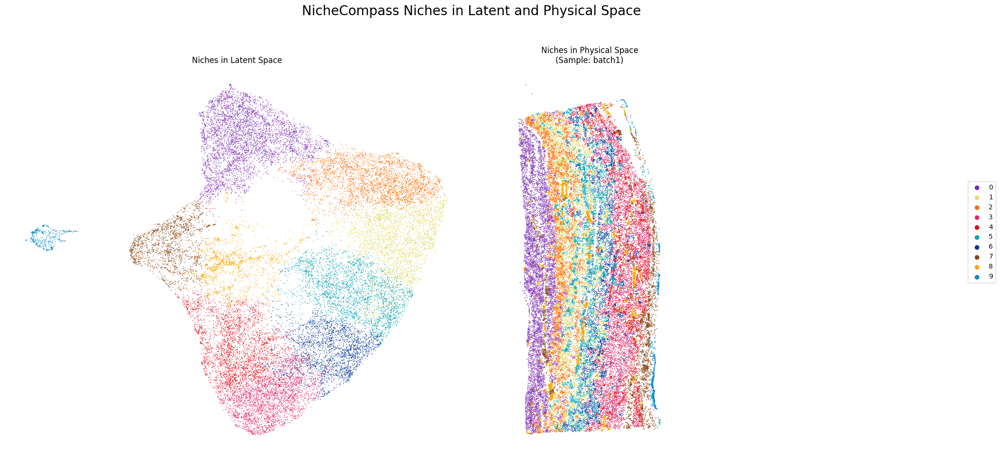

In [33]:
groups = None
save_fig = True
file_path = f"{figure_folder_path}/res_{latent_leiden_resolution}_niches_latent_physical_space.svg"

n_spatial_rows = (len(samples) + 1) // 2  # Round up division by 2

fig = plt.figure(figsize=(20, 5 + 5 * n_spatial_rows))
title = fig.suptitle(t="NicheCompass Niches in Latent and Physical Space",
                     y=0.98,
                     fontsize=20)

gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

gs_left = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec=gs[0])
ax_umap = fig.add_subplot(gs_left[0])

gs_right = gridspec.GridSpecFromSubplotSpec(n_spatial_rows, 2, subplot_spec=gs[1])

sc.pl.umap(adata=model.adata,
           color=[latent_cluster_key],
           groups=groups,
           palette=latent_cluster_colors,
           title="Niches in Latent Space",
           ax=ax_umap,
           frameon=False,
           size=5,
           show=False)

for idx, sample in enumerate(samples):
    row = idx // 2
    col = idx % 2
    ax = fig.add_subplot(gs_right[row, col])
    sc.pl.spatial(adata=model.adata[model.adata.obs[sample_key] == sample],
                  color=[latent_cluster_key],
                  groups=groups,
                  palette=latent_cluster_colors,
                  spot_size=spot_size,
                  title=f"Niches in Physical Space\n(Sample: {sample})",
                  legend_loc=None,
                  ax=ax,
                  frameon=False,
                  size=0.6,
                  show=False)

handles, labels = ax_umap.get_legend_handles_labels()
lgd = fig.legend(handles,
                 labels,
                 loc="center left",
                 bbox_to_anchor=(1.02, 0.5))
ax_umap.get_legend().remove()

plt.tight_layout(rect=[0, 0.02, 1, 0.95])  # Adjust the rect parameters as needed

if save_fig:
    fig.savefig(file_path,
                bbox_extra_artists=(lgd, title),
                bbox_inches="tight")
plt.show()

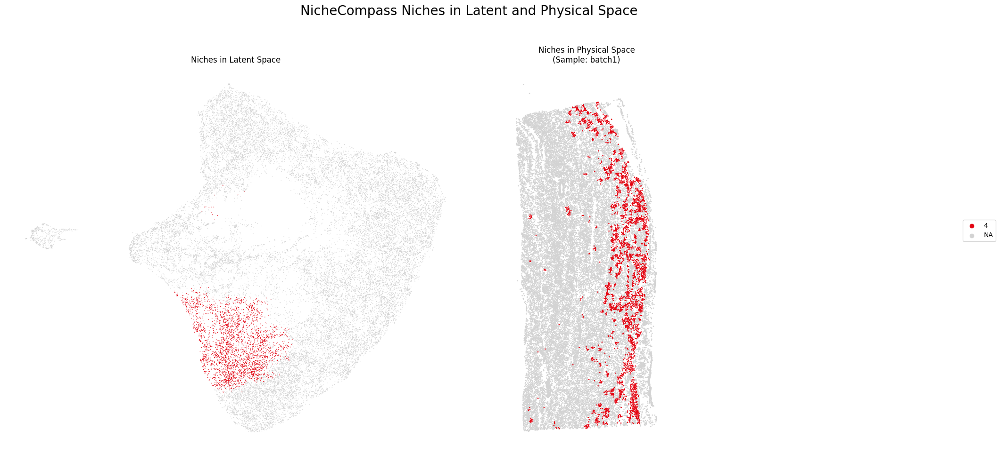

In [34]:
#groups = ['8', '5', '9', '4']
groups = ['4']
save_fig = True
file_path = f"{figure_folder_path}/res_{latent_leiden_resolution}_niches_latent_physical_space.svg"

n_spatial_rows = (len(samples) + 1) // 2  # Round up division by 2

fig = plt.figure(figsize=(20, 5 + 5 * n_spatial_rows))
title = fig.suptitle(t="NicheCompass Niches in Latent and Physical Space",
                     y=0.98,
                     fontsize=20)

gs = gridspec.GridSpec(1, 2, width_ratios=[1, 1])

gs_left = gridspec.GridSpecFromSubplotSpec(1, 1, subplot_spec=gs[0])
ax_umap = fig.add_subplot(gs_left[0])

gs_right = gridspec.GridSpecFromSubplotSpec(n_spatial_rows, 2, subplot_spec=gs[1])

sc.pl.umap(adata=model.adata,
           color=[latent_cluster_key],
           groups=groups,
           palette=latent_cluster_colors,
           title="Niches in Latent Space",
           ax=ax_umap,
           frameon=False,
           size=5,
           show=False)

for idx, sample in enumerate(samples):
    row = idx // 2
    col = idx % 2
    ax = fig.add_subplot(gs_right[row, col])
    sc.pl.spatial(adata=model.adata[model.adata.obs[sample_key] == sample],
                  color=[latent_cluster_key],
                  groups=groups,
                  palette=latent_cluster_colors,
                  spot_size=spot_size,
                  title=f"Niches in Physical Space\n(Sample: {sample})",
                  legend_loc=None,
                  ax=ax,
                  frameon=False,
                  size=0.8,
                  show=False)

handles, labels = ax_umap.get_legend_handles_labels()
lgd = fig.legend(handles,
                 labels,
                 loc="center left",
                 bbox_to_anchor=(1.02, 0.5))
ax_umap.get_legend().remove()

plt.tight_layout(rect=[0, 0.02, 1, 0.95])  # Adjust the rect parameters as needed

if save_fig:
    fig.savefig(file_path,
                bbox_extra_artists=(lgd, title),
                bbox_inches="tight")
plt.show()

### Characterise Niches

- Niche Composition

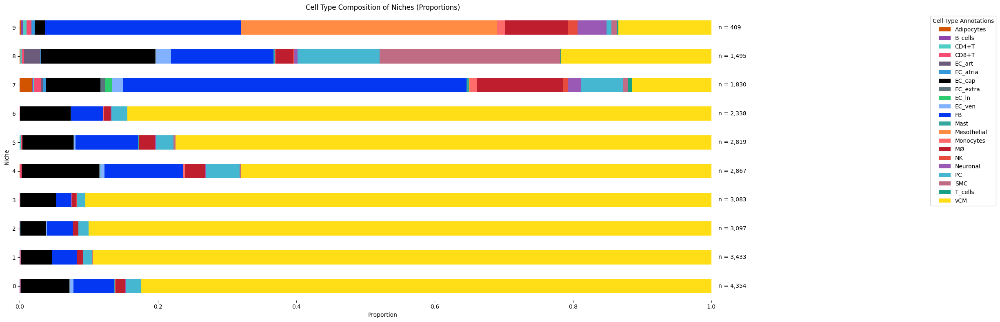

In [35]:
save_fig = True
file_path = f"{figure_folder_path}/" \
            f"res_{latent_leiden_resolution}_" \
            f"niche_composition_proportions_frameless.svg"

df_counts = (model.adata.obs.groupby([latent_cluster_key, cell_type_key])
             .size().unstack().fillna(0))

df_proportions = df_counts.div(df_counts.sum(axis=1), axis=0)

colors = [cell_type_colors.get(cell_type, '#000000') for cell_type in df_proportions.columns]

fig, ax = plt.subplots(figsize=(25, 8))
df_proportions.plot(kind="barh", stacked=True, ax=ax, color=colors)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

for i, total in enumerate(df_counts.sum(axis=1)):
    ax.text(1.01, i, f'n = {total:,}', va='center')

handles, labels = ax.get_legend_handles_labels()
legend = ax.legend(handles, labels, bbox_to_anchor=(1.25, 1), loc="upper left", prop={'size': 10})
legend.set_title("Cell Type Annotations", prop={'size': 10})

plt.title("Cell Type Composition of Niches (Proportions)")
plt.xlabel("Proportion")
plt.ylabel("Niche")

plt.tight_layout()

if save_fig:
    plt.savefig(file_path,
                bbox_extra_artists=(legend,),
                bbox_inches="tight")

plt.show()

In [36]:
def create_waffle_plots(df_counts, cell_type_colors, figure_folder_path, latent_leiden_resolution):
    print(f"Number of niches: {len(df_counts)}")
    print(f"Cell types: {df_counts.columns.tolist()}")
    print("\nSample of the data:")
    print(df_counts.head())

    n_niches = len(df_counts)
    n_cols = min(4, n_niches)
    n_rows = math.ceil(n_niches / n_cols)
    
    fig = plt.figure(figsize=(9 * n_cols, 7 * n_rows), constrained_layout=False)
    plt.subplots_adjust(hspace=0.8, wspace=0.4)
    
    for idx, (niche, composition) in enumerate(df_counts.iterrows(), 1):
        composition_pct = composition / composition.sum() * 100
        composition_pct = composition_pct[composition_pct > 0]
        composition_pct = composition_pct.sort_values(ascending = False)
        
        colors = [cell_type_colors.get(cell_type, '#000000') for cell_type in composition_pct.index]
        
        values = [max(0.5, value) for value in composition_pct]
        
        ax = fig.add_subplot(n_rows, n_cols, idx)
        
        Waffle.make_waffle(
            ax=ax,
            values=values,
            labels=[f"{cell_type} ({value:.1f}%)" for cell_type, value in composition_pct.items()],
            legend={'loc': 'lower center', 'bbox_to_anchor': (0.5, -0.4), 'ncol': 4, 'fontsize': 9},
            title={'label': f'Niche {niche}', 'loc': 'center', 'fontsize': 12},
            colors=colors,
            plot_anchor='C',
            icons='square',
            icon_size=15,
            icon_legend=True,
            rows=10,
            columns=20,
            interval_ratio_x=0.05,
            interval_ratio_y=0.05,
            font_size=6,
            block_arranging_style='snake',
            starting_location='NW',
            round_values=False
        )
    
    plt.suptitle(f"Cell Type Composition of Niches (Resolution: {latent_leiden_resolution})", 
                 fontsize=16, y=0.98)
    
    for format in ['png', 'pdf', 'svg']:
        file_path = os.path.join(figure_folder_path, f"res_{latent_leiden_resolution}_niche_composition_waffle_compact_all_proportions.{format}")
        plt.savefig(file_path, bbox_inches="tight", dpi=300)
        print(f"Waffle plots saved to: {file_path}")

    plt.show()
    plt.close()

Number of niches: 10
Cell types: ['Adipocytes', 'B_cells', 'CD4+T', 'CD8+T', 'EC_art', 'EC_atria', 'EC_cap', 'EC_extra', 'EC_ln', 'EC_ven', 'FB', 'Mast', 'Mesothelial', 'Monocytes', 'MØ', 'NK', 'Neuronal', 'PC', 'SMC', 'T_cells', 'vCM']

Sample of the data:
cell_type          Adipocytes  B_cells  CD4+T  CD8+T  EC_art  EC_atria  \
latent_leiden_0.4                                                        
0                           0        1      0      4       2         2   
1                           0        1      2      3       0         1   
2                           0        1      2      1       0         0   
3                           0        0      0      2       1         0   
4                           1        1      0      6       1         0   

cell_type          EC_cap  EC_extra  EC_ln  EC_ven  ...  Mast  Mesothelial  \
latent_leiden_0.4                                   ...                      
0                     301         6      1      23  ...     3      

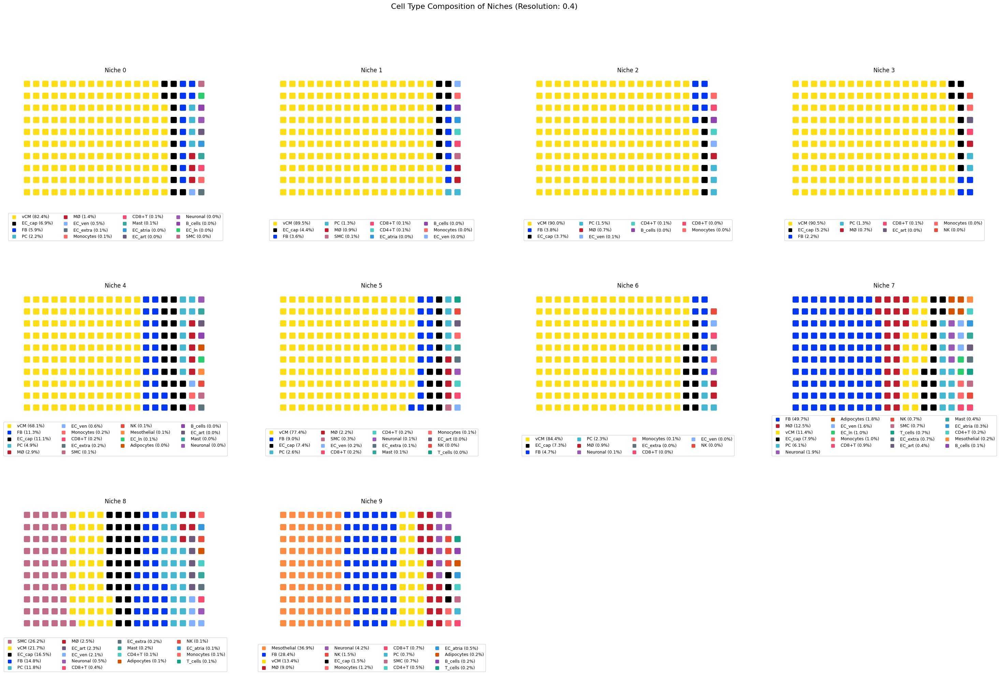

In [37]:
create_waffle_plots(df_counts, cell_type_colors, figure_folder_path, latent_leiden_resolution)

#### 4.3.2 Differential GPs

Now we can test which GPs are differentially expressed in a niche. To this end, we will perform "one-vs-rest" differential GP testing, i.e all niches (```selected_cats = None```) are tested against all other niches (```comparison_cats = "rest"```). However, differential GP testing can also be performed in the following ways:
- Set ```selected_cats = ["0"]``` to perform differential GP testing for a specific niche only, in this case niche "0".
- Set ```comparison_cats = ["2"]``` to perform differential GP testing against niche "2" as opposed to against all other niches.

We choose an absolute log bayes factor threshold of 2.3 to determine strongly enriched GPs (see https://en.wikipedia.org/wiki/Bayes_factor).

In [38]:
# Check number of active GPs
active_gps = model.get_active_gps()
print(f"Number of total gene programs: {len(model.adata.uns[gp_names_key])}.")
print(f"Number of active gene programs: {len(active_gps)}.")

Number of total gene programs: 158.
Number of active gene programs: 61.


In [39]:
# Display example active GPs
gp_summary_df = model.get_gp_summary()
gp_summary_df[gp_summary_df["gp_active"] == True].head()

,gp_name,all_gp_idx,gp_active,active_gp_idx,n_source_genes,n_non_zero_source_genes,n_target_genes,n_non_zero_target_genes,gp_source_genes,gp_target_genes,gp_source_genes_weights,gp_target_genes_weights,gp_source_genes_importances,gp_target_genes_importances
1,S100A1_ligand_receptor_GP,1,True,0,1,1,1,1,[S100A1],[AGER],[-2.0907],[0.3525],[0.8557],[0.1443]
2,ADAM28_ligand_receptor_target_gene_GP,2,True,1,1,1,20,20,[ADAM28],"[FHL2, IGF1, CDK1, BAMBI, TNC, CAV1, MDM2, ESR...",[-0.9988],"[1.665, 0.441, -0.4258, 0.3317, -0.3086, 0.254...",[0.1643],"[0.2739, 0.0726, 0.07, 0.0546, 0.0508, 0.0419,..."
3,ANPEP_ligand_receptor_target_gene_GP,3,True,2,1,1,22,22,[ANPEP],"[PRDM1, CAV1, CXCR4, FAS, EGFR, PPARG, CDK1, S...",[0.0343],"[-0.1318, 0.124, -0.1081, 0.1044, 0.0995, -0.0...",[0.0245],"[0.0939, 0.0884, 0.077, 0.0744, 0.0709, 0.0661..."
4,APOA5_ligand_receptor_target_gene_GP,4,True,3,1,1,19,19,[APOA5],"[ERBB2, STC2, MDM2, MYC, BCL2L11, TOP2A, PPARG...",[-0.0176],"[0.1585, 0.0972, 0.0877, -0.0751, 0.0569, 0.04...",[0.0219],"[0.1971, 0.1208, 0.1091, 0.0934, 0.0707, 0.056..."
5,BTNL9_ligand_receptor_target_gene_GP,5,True,4,1,1,29,29,[BTNL9],"[EGFR, CXCL10, CYP1A1, CCL5, STC1, VCAN, PPARG...",[0.0245],"[0.0696, 0.0647, 0.0514, 0.0496, -0.0467, 0.04...",[0.0317],"[0.09, 0.0836, 0.0664, 0.0641, 0.0604, 0.059, ..."


In [40]:
# Set parameters for differential gp testing
selected_cats = None
#selected_cats = '5'
comparison_cats = "rest"
title = f"NicheCompass Strongly Enriched Niche GPs"
log_bayes_factor_thresh = 2.3
save_fig = True
file_path = f"{figure_folder_path}/" \
            f"/log_bayes_factor_{log_bayes_factor_thresh}" \
             "_niches_enriched_gps_heatmap.svg"

In [41]:
# Run differential gp testing
enriched_gps = model.run_differential_gp_tests(
    cat_key=latent_cluster_key,
    selected_cats=selected_cats,
    comparison_cats=comparison_cats,
    log_bayes_factor_thresh=log_bayes_factor_thresh)

In [42]:
# Results are stored in a df in the adata object
model.adata.uns[differential_gp_test_results_key]

,category,gene_program,p_h0,p_h1,log_bayes_factor
0,9,S100A1_ligand_receptor_GP,1.000000e+00,5.251677e-11,23.651026
1,9,LIF_combined_GP,2.137446e-08,1.000000e+00,-17.661022
2,9,VWF_combined_GP,9.999997e-01,3.236120e-07,14.943717
3,9,LPL_ligand_receptor_target_gene_GP,9.999990e-01,1.033929e-06,13.782143
4,9,PRG4_ligand_receptor_target_gene_GP,9.088041e-06,9.999909e-01,-11.608542
...,...,...,...,...,...
62,2,CXCL2_combined_GP,9.115127e-01,8.848727e-02,2.332247
63,2,CCL19_combined_GP,9.094696e-01,9.053042e-02,2.307176
64,3,ANPEP_ligand_receptor_target_gene_GP,9.058618e-02,9.094138e-01,-2.306499
65,0,PTN_combined_GP,9.062944e-02,9.093706e-01,-2.305974


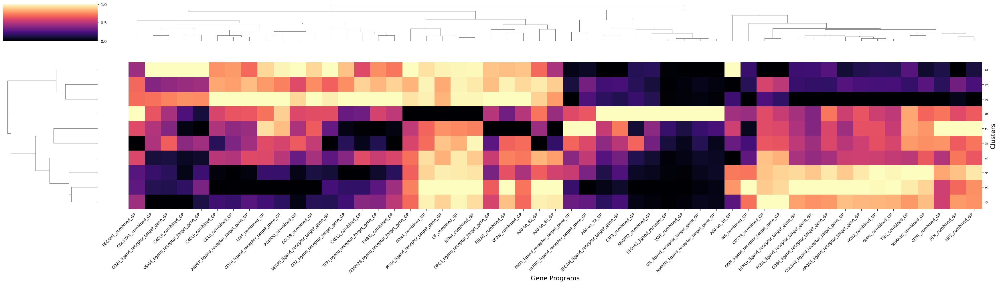

In [43]:
# Assuming you have already created 'df' as in your original code
df = model.adata.obs[[latent_cluster_key] + enriched_gps].groupby(latent_cluster_key).mean()

scaler = MinMaxScaler()
normalized_columns = scaler.fit_transform(df)
normalized_df = pd.DataFrame(normalized_columns, columns=df.columns)
normalized_df.index = df.index

# Compute the linkage matrix for rows and columns
row_linkage = hierarchy.linkage(normalized_df, method='average')
col_linkage = hierarchy.linkage(normalized_df.T, method='average')

# Set the figure size
figsize = (35, 10)  # Adjust these values to change the figure size

# Create the clustermap
g = sns.clustermap(normalized_df,
                   cmap='magma',
                   row_linkage=row_linkage,
                   col_linkage=col_linkage,
                   dendrogram_ratio=(0.1, 0.2),
                   cbar_pos=(0.02, 0.8, 0.05, 0.18),
                   linewidths=0,
                   xticklabels=True,
                   yticklabels=True,
                   figsize=figsize)

# Rotate x-axis labels
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=45, ha='right', fontsize=10)

# Set labels
g.ax_heatmap.set_xlabel("Gene Programs", fontsize=16)
g.ax_heatmap.set_ylabel("Clusters", fontsize=16)

# Adjust the figure size after creating the clustermap
g.fig.set_size_inches(figsize)

# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Save the figure
plt.savefig(f"{figure_folder_path}/enriched_gps_heatmap_clustered.svg",
            bbox_inches="tight",
            dpi=300)

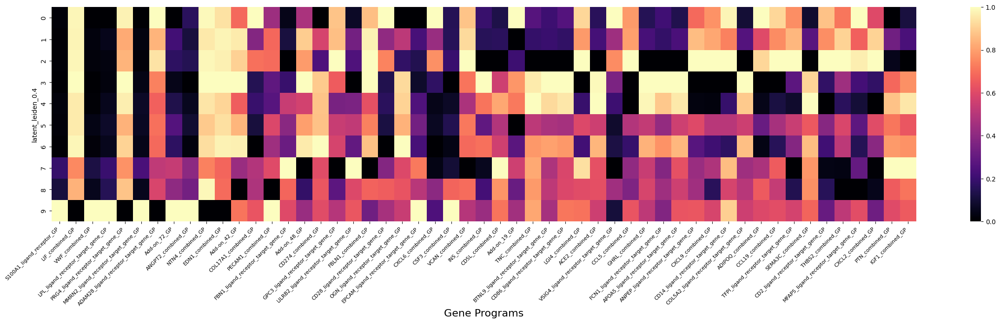

In [44]:
# Visualize GP activities of enriched GPs across niches
df = model.adata.obs[[latent_cluster_key] + enriched_gps].groupby(latent_cluster_key).mean()

scaler = MinMaxScaler()
normalized_columns = scaler.fit_transform(df)
normalized_df = pd.DataFrame(normalized_columns, columns=df.columns)
normalized_df.index = df.index

plt.figure(figsize=(30, 6))  # Set the figure size
ax = sns.heatmap(normalized_df,
            cmap='magma',
            annot=False,
            linewidths=0)
plt.xticks(rotation=45,
           fontsize=8,
           ha="right"
          )
plt.xlabel("Gene Programs", fontsize=16)
plt.savefig(f"{figure_folder_path}/enriched_gps_heatmap.svg",
            bbox_inches="tight")

In [45]:
# Store gene program summary of enriched gene programs
save_file = True
file_path = f"{figure_folder_path}/" \
            f"/log_bayes_factor_{log_bayes_factor_thresh}_" \
            "niche_enriched_gps_summary.csv"

gp_summary_cols = ["gp_name",
                   "n_source_genes",
                   "n_non_zero_source_genes",
                   "n_target_genes",
                   "n_non_zero_target_genes",
                   "gp_source_genes",
                   "gp_target_genes",
                   "gp_source_genes_importances",
                   "gp_target_genes_importances"]

enriched_gp_summary_df = gp_summary_df[gp_summary_df["gp_name"].isin(enriched_gps)]
cat_dtype = pd.CategoricalDtype(categories=enriched_gps, ordered=True)
enriched_gp_summary_df.loc[:, "gp_name"] = enriched_gp_summary_df["gp_name"].astype(cat_dtype)
enriched_gp_summary_df = enriched_gp_summary_df.sort_values(by="gp_name")
enriched_gp_summary_df = enriched_gp_summary_df[gp_summary_cols]

if save_file:
    enriched_gp_summary_df.to_csv(f"{file_path}")
else:
    display(enriched_gp_summary_df)

Now we will have a look at the GP activities and the log normalized counts of
the most important omics features of the differential GPs.

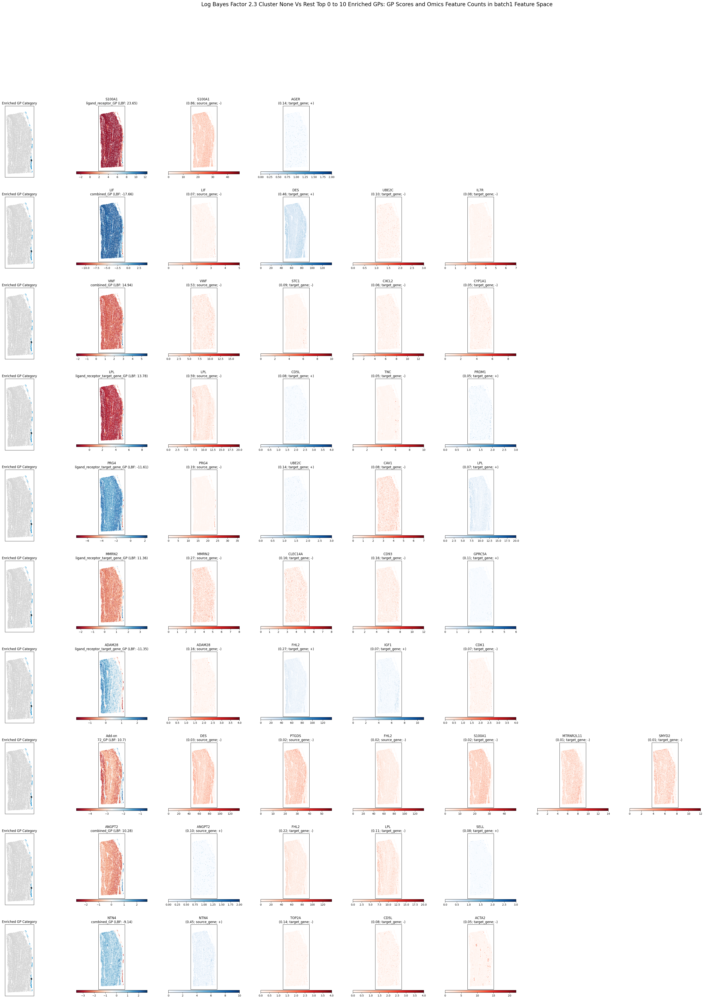

In [46]:
plot_label = f"log_bayes_factor_{log_bayes_factor_thresh}_cluster_{selected_cats[0] if selected_cats else 'None'}_vs_rest"
save_figs = True

generate_enriched_gp_info_plots(
    plot_label=plot_label,
    model=model,
    sample_key=sample_key,
    differential_gp_test_results_key=differential_gp_test_results_key,
    cat_key=latent_cluster_key,
    cat_palette=latent_cluster_colors,
    n_top_enriched_gp_start_idx=0,
    n_top_enriched_gp_end_idx=10,
    feature_spaces=samples, # ["latent"]
    n_top_genes_per_gp=3,
    save_figs=save_figs,
    figure_folder_path=f"{figure_folder_path}/",
    spot_size=spot_size)

In [47]:
model.adata.uns["nichecompass_differential_gp_test_results"]

,category,gene_program,p_h0,p_h1,log_bayes_factor
0,9,S100A1_ligand_receptor_GP,1.000000e+00,5.251677e-11,23.651026
1,9,LIF_combined_GP,2.137446e-08,1.000000e+00,-17.661022
2,9,VWF_combined_GP,9.999997e-01,3.236120e-07,14.943717
3,9,LPL_ligand_receptor_target_gene_GP,9.999990e-01,1.033929e-06,13.782143
4,9,PRG4_ligand_receptor_target_gene_GP,9.088041e-06,9.999909e-01,-11.608542
...,...,...,...,...,...
62,2,CXCL2_combined_GP,9.115127e-01,8.848727e-02,2.332247
63,2,CCL19_combined_GP,9.094696e-01,9.053042e-02,2.307176
64,3,ANPEP_ligand_receptor_target_gene_GP,9.058618e-02,9.094138e-01,-2.306499
65,0,PTN_combined_GP,9.062944e-02,9.093706e-01,-2.305974


In [48]:
gp_summary_df = model.get_gp_summary()
gp_summary_df[gp_summary_df["gp_active"] == True].head()

,gp_name,all_gp_idx,gp_active,active_gp_idx,n_source_genes,n_non_zero_source_genes,n_target_genes,n_non_zero_target_genes,gp_source_genes,gp_target_genes,gp_source_genes_weights,gp_target_genes_weights,gp_source_genes_importances,gp_target_genes_importances
1,S100A1_ligand_receptor_GP,1,True,0,1,1,1,1,[S100A1],[AGER],[-2.0907],[0.3525],[0.8557],[0.1443]
2,ADAM28_ligand_receptor_target_gene_GP,2,True,1,1,1,20,20,[ADAM28],"[FHL2, IGF1, CDK1, BAMBI, TNC, CAV1, MDM2, ESR...",[-0.9988],"[1.665, 0.441, -0.4258, 0.3317, -0.3086, 0.254...",[0.1643],"[0.2739, 0.0726, 0.07, 0.0546, 0.0508, 0.0419,..."
3,ANPEP_ligand_receptor_target_gene_GP,3,True,2,1,1,22,22,[ANPEP],"[PRDM1, CAV1, CXCR4, FAS, EGFR, PPARG, CDK1, S...",[0.0343],"[-0.1318, 0.124, -0.1081, 0.1044, 0.0995, -0.0...",[0.0245],"[0.0939, 0.0884, 0.077, 0.0744, 0.0709, 0.0661..."
4,APOA5_ligand_receptor_target_gene_GP,4,True,3,1,1,19,19,[APOA5],"[ERBB2, STC2, MDM2, MYC, BCL2L11, TOP2A, PPARG...",[-0.0176],"[0.1585, 0.0972, 0.0877, -0.0751, 0.0569, 0.04...",[0.0219],"[0.1971, 0.1208, 0.1091, 0.0934, 0.0707, 0.056..."
5,BTNL9_ligand_receptor_target_gene_GP,5,True,4,1,1,29,29,[BTNL9],"[EGFR, CXCL10, CYP1A1, CCL5, STC1, VCAN, PPARG...",[0.0245],"[0.0696, 0.0647, 0.0514, 0.0496, -0.0467, 0.04...",[0.0317],"[0.09, 0.0836, 0.0664, 0.0641, 0.0604, 0.059, ..."


In [54]:
model.adata.uns['nichecompass_gp_summary'] = gp_summary_df.copy()
model.adata

AnnData object with n_obs × n_vars = 25725 × 310
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'cell_labels', 'n_counts', 'cell_type', 'batch', 'latent_leiden_0.4', 'S100A1_ligand_receptor_GP', 'LIF_combined_GP', 'VWF_combined_GP', 'LPL_ligand_receptor_target_gene_GP', 'PRG4_ligand_receptor_target_gene_GP', 'MMRN2_ligand_receptor_target_gene_GP', 'ADAM28_ligand_receptor_target_gene_GP', 'Add-on_72_GP', 'ANGPT2_combined_GP', 'NTN4_combined_GP', 'EDN1_combined_GP', 'Add-on_42_GP', 'COL17A1_combined_GP', 'PECAM1_combined_GP', 'FBN1_ligand_receptor_target_gene_GP', 'Add-on_48_GP', 'CD274_combined_GP', 'GPC3_ligand_receptor_target_gene_GP', 'LILRB2_ligand_receptor_target_gene_GP', 'FBLN1_combined_GP', 'CD28_ligand_receptor_target_gene_GP', 'OGN_ligand_receptor_target_gene_GP', 'EPCAM_ligand_receptor_target_gene_GP', 'CXCL6_combined_

In [56]:
def safe_list_to_string(x):
    if isinstance(x, (list, np.ndarray)):
        return ', '.join(map(str, x))
    elif pd.isna(x):
        return ''
    elif isinstance(x, (int, float, bool)):
        return str(x)
    else:
        return str(x)

In [59]:
for key, value in model.adata.uns.items():
    if isinstance(value, pd.DataFrame):
        model.adata.uns[key] = value.applymap(safe_list_to_string)

In [60]:
model.adata.write(f"{artifacts_folder_path}/single_sample/{load_timestamp}/adata_results.h5ad")

In [61]:
model.adata

AnnData object with n_obs × n_vars = 25725 × 310
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region', 'cell_labels', 'n_counts', 'cell_type', 'batch', 'latent_leiden_0.4', 'S100A1_ligand_receptor_GP', 'LIF_combined_GP', 'VWF_combined_GP', 'LPL_ligand_receptor_target_gene_GP', 'PRG4_ligand_receptor_target_gene_GP', 'MMRN2_ligand_receptor_target_gene_GP', 'ADAM28_ligand_receptor_target_gene_GP', 'Add-on_72_GP', 'ANGPT2_combined_GP', 'NTN4_combined_GP', 'EDN1_combined_GP', 'Add-on_42_GP', 'COL17A1_combined_GP', 'PECAM1_combined_GP', 'FBN1_ligand_receptor_target_gene_GP', 'Add-on_48_GP', 'CD274_combined_GP', 'GPC3_ligand_receptor_target_gene_GP', 'LILRB2_ligand_receptor_target_gene_GP', 'FBLN1_combined_GP', 'CD28_ligand_receptor_target_gene_GP', 'OGN_ligand_receptor_target_gene_GP', 'EPCAM_ligand_receptor_target_gene_GP', 'CXCL6_combined_

: 

#### 4.3.3 Cell-cell Communication

Now we will use the inferred activity of an enriched combined interaction GP to analyze the involved intercellular interactions.

In [50]:
gp_name = "FBN1_ligand_receptor_target_gene_GP"

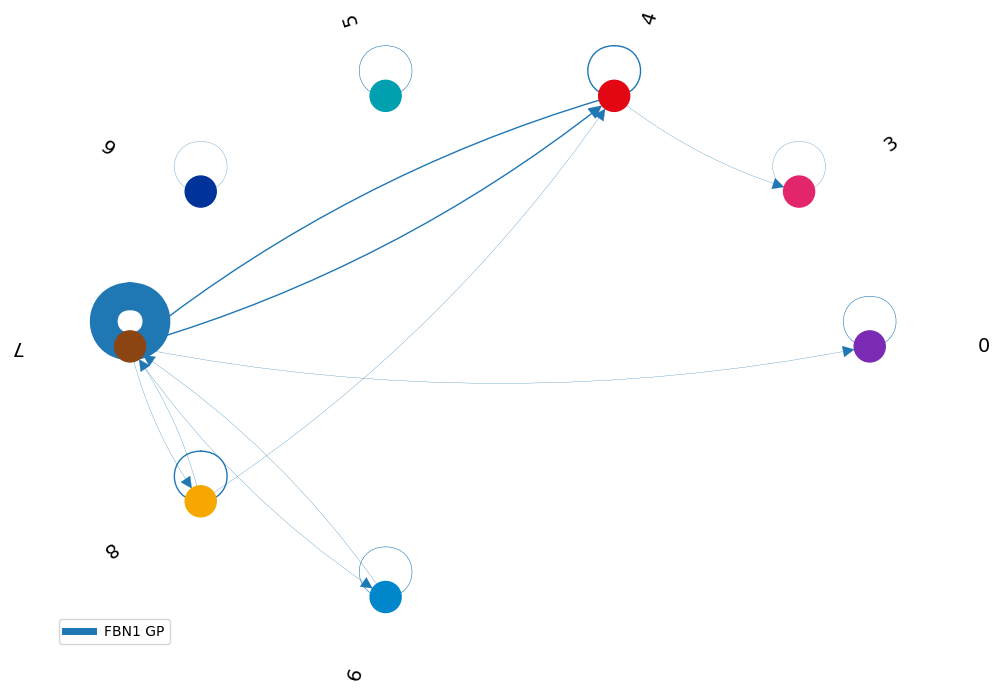

In [51]:
network_df = compute_communication_gp_network(
    gp_list=[gp_name],
    model=model,
    group_key=latent_cluster_key,
    n_neighbors=n_neighbors)

visualize_communication_gp_network(
    adata=model.adata,
    network_df=network_df,
    figsize=(10, 7),
    cat_colors=latent_cluster_colors,
    edge_type_colors=["#1f77b4"], 
    cat_key=latent_cluster_key,
    save=True,
    save_path=f"{figure_folder_path}/gp_network_{gp_name}.svg",
    )